In [1]:
from shapely.geometry import Point
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
import datetime
%matplotlib inline

In [2]:
Phone_Calls_Derechopd = pd.read_csv ('../data/911_Phone_Calls_Derecho.csv')
Phone_Calls_Derechopd

,DateTime,CallTypeId,Latitude,Longitude,Cell_Tower_Address
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER
1,5/3/2020 16:30,911 Calls,36.143108,-86.800621,1161 21ST AV S - SE
2,5/3/2020 16:30,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N
3,5/3/2020 16:30,911 Calls,36.130021,-86.927819,5758 RIVER RD - SW
4,5/3/2020 16:31,911 Calls,36.142380,-86.881882,3744B ANNEX AVE - SE
...,...,...,...,...,...
1510,5/4/2020 0:18,911 Calls,36.131694,-86.770535,1823-C 12TH AV - SECTOR SE S
1511,5/4/2020 0:22,911 Calls,36.042237,-86.743455,5244-C EDMONSON PIKE - SECTOR SE
1512,5/4/2020 0:25,911 Calls,36.077664,-86.655607,2747-B MURFREESBORO PKE - SECTOR NW
1513,5/4/2020 0:29,911 Calls,36.024706,-86.743562,302 SUMMIT VIEW DR - E


In [3]:
zipcodes= gpd.read_file ('../data/zipcodes.geojson')
print(zipcodes.crs)
zipcodes.head ()

epsg:4326


,zip,objectid,po_name,shape_stlength,shape_starea,geometry
0,37115,1,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ..."
1,37203,33,NASHVILLE,93532.890729543782,120334624.37817383,"MULTIPOLYGON (((-86.78734 36.16688, -86.78711 ..."
2,37204,9,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ..."
3,37064,18,FRANKLIN,28995.828320601937,46969608.005737305,"MULTIPOLYGON (((-87.02197 36.01200, -87.02140 ..."
4,37246,57,NASHVILLE,2247.4521491892065,315078.17651367187,"MULTIPOLYGON (((-86.79052 36.15846, -86.79107 ..."


In [4]:
type(zipcodes)

geopandas.geodataframe.GeoDataFrame

<AxesSubplot:>

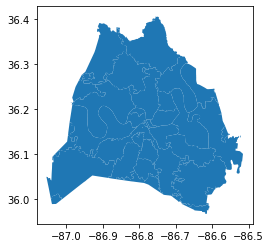

In [5]:
zipcodes.plot ()

In [6]:
Phone_Calls_Derechopd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1515 entries, 0 to 1514
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   DateTime            1515 non-null   object 
 1   CallTypeId          1515 non-null   object 
 2   Latitude            1515 non-null   float64
 3   Longitude           1515 non-null   float64
 4   Cell_Tower_Address  1515 non-null   object 
dtypes: float64(2), object(3)
memory usage: 59.3+ KB


In [7]:
Phone_Calls_Derechopd['geometry']= Phone_Calls_Derechopd.apply(lambda x: Point ((float(x.Longitude),
                                                                                 float(x.Latitude))),
                                                                axis = 1)
Phone_Calls_Derechopd

,DateTime,CallTypeId,Latitude,Longitude,Cell_Tower_Address,geometry
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER,POINT (-86.716847 36.247802)
1,5/3/2020 16:30,911 Calls,36.143108,-86.800621,1161 21ST AV S - SE,POINT (-86.80062100000001 36.143108)
2,5/3/2020 16:30,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N,POINT (-87.05632900000001 36.100516)
3,5/3/2020 16:30,911 Calls,36.130021,-86.927819,5758 RIVER RD - SW,POINT (-86.927819 36.130021)
4,5/3/2020 16:31,911 Calls,36.142380,-86.881882,3744B ANNEX AVE - SE,POINT (-86.881882 36.14238)
...,...,...,...,...,...,...
1510,5/4/2020 0:18,911 Calls,36.131694,-86.770535,1823-C 12TH AV - SECTOR SE S,POINT (-86.770535 36.131694)
1511,5/4/2020 0:22,911 Calls,36.042237,-86.743455,5244-C EDMONSON PIKE - SECTOR SE,POINT (-86.743455 36.042237)
1512,5/4/2020 0:25,911 Calls,36.077664,-86.655607,2747-B MURFREESBORO PKE - SECTOR NW,POINT (-86.655607 36.077664)
1513,5/4/2020 0:29,911 Calls,36.024706,-86.743562,302 SUMMIT VIEW DR - E,POINT (-86.743562 36.024706)


In [8]:
Phone_Calls_Derechopd.drop(columns= ('Cell_Tower_Address'))

,DateTime,CallTypeId,Latitude,Longitude,geometry
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,POINT (-86.716847 36.247802)
1,5/3/2020 16:30,911 Calls,36.143108,-86.800621,POINT (-86.80062100000001 36.143108)
2,5/3/2020 16:30,911 Calls,36.100516,-87.056329,POINT (-87.05632900000001 36.100516)
3,5/3/2020 16:30,911 Calls,36.130021,-86.927819,POINT (-86.927819 36.130021)
4,5/3/2020 16:31,911 Calls,36.142380,-86.881882,POINT (-86.881882 36.14238)
...,...,...,...,...,...
1510,5/4/2020 0:18,911 Calls,36.131694,-86.770535,POINT (-86.770535 36.131694)
1511,5/4/2020 0:22,911 Calls,36.042237,-86.743455,POINT (-86.743455 36.042237)
1512,5/4/2020 0:25,911 Calls,36.077664,-86.655607,POINT (-86.655607 36.077664)
1513,5/4/2020 0:29,911 Calls,36.024706,-86.743562,POINT (-86.743562 36.024706)


In [9]:
type (Phone_Calls_Derechopd)

pandas.core.frame.DataFrame

# Turning The data frame into a geometry, so we can add the points to the map.

In [10]:
Phone_Calls_Derechopd_geo = gpd.GeoDataFrame(Phone_Calls_Derechopd,
                                             crs = zipcodes.crs, 
                                             geometry = Phone_Calls_Derechopd.geometry)
Phone_Calls_Derechopd_geo

,DateTime,CallTypeId,Latitude,Longitude,Cell_Tower_Address,geometry
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER,POINT (-86.71685 36.24780)
1,5/3/2020 16:30,911 Calls,36.143108,-86.800621,1161 21ST AV S - SE,POINT (-86.80062 36.14311)
2,5/3/2020 16:30,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N,POINT (-87.05633 36.10052)
3,5/3/2020 16:30,911 Calls,36.130021,-86.927819,5758 RIVER RD - SW,POINT (-86.92782 36.13002)
4,5/3/2020 16:31,911 Calls,36.142380,-86.881882,3744B ANNEX AVE - SE,POINT (-86.88188 36.14238)
...,...,...,...,...,...,...
1510,5/4/2020 0:18,911 Calls,36.131694,-86.770535,1823-C 12TH AV - SECTOR SE S,POINT (-86.77053 36.13169)
1511,5/4/2020 0:22,911 Calls,36.042237,-86.743455,5244-C EDMONSON PIKE - SECTOR SE,POINT (-86.74345 36.04224)
1512,5/4/2020 0:25,911 Calls,36.077664,-86.655607,2747-B MURFREESBORO PKE - SECTOR NW,POINT (-86.65561 36.07766)
1513,5/4/2020 0:29,911 Calls,36.024706,-86.743562,302 SUMMIT VIEW DR - E,POINT (-86.74356 36.02471)


In [11]:
Phone_Calls_Derechopd_zip = gpd.sjoin(Phone_Calls_Derechopd_geo, zipcodes, op='within')
Phone_Calls_Derechopd_zip

,DateTime,CallTypeId,Latitude,Longitude,Cell_Tower_Address,geometry,index_right,zip,objectid,po_name,shape_stlength,shape_starea
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER,POINT (-86.71685 36.24780),0,37115,1,MADISON,178783.02488886821,596553400.57885742
65,5/3/2020 16:44,911 Calls,36.265547,-86.736116,524 BOYDS HILLTOP DR - SW,POINT (-86.73612 36.26555),0,37115,1,MADISON,178783.02488886821,596553400.57885742
75,5/3/2020 16:46,911 Calls,36.250710,-86.689766,607E LARKIN SPRINGS RD - SW,POINT (-86.68977 36.25071),0,37115,1,MADISON,178783.02488886821,596553400.57885742
76,5/3/2020 16:46,911 Calls,36.259485,-86.678717,96 D VANDIVER DR - SECTOR S,POINT (-86.67872 36.25948),0,37115,1,MADISON,178783.02488886821,596553400.57885742
97,5/3/2020 16:51,911 Calls,36.253467,-86.730366,619 DUE WEST AVE. W - NE SECTOR,POINT (-86.73037 36.25347),0,37115,1,MADISON,178783.02488886821,596553400.57885742
...,...,...,...,...,...,...,...,...,...,...,...,...
848,5/3/2020 19:20,911 Calls,36.168324,-86.783089,500 5TH AV - SECTOR SW N,POINT (-86.78309 36.16832),15,37219,15,NASHVILLE,21013.192337432083,6579013.4385986328
860,5/3/2020 19:22,911 Calls,36.165715,-86.782079,315-B 4TH AV - SECTOR NW N,POINT (-86.78208 36.16571),15,37219,15,NASHVILLE,21013.192337432083,6579013.4385986328
985,5/3/2020 19:53,911 Calls,36.193784,-86.787897,275 CUMBERLAND BEND,POINT (-86.78790 36.19378),30,37228,13,NASHVILLE,38325.180077725185,47878303.581787109
1470,5/3/2020 23:25,911 Calls,36.004472,-86.695497,1598-A RAGSDALE RD - SECTOR N,POINT (-86.69550 36.00447),10,37027,30,BRENTWOOD,30401.649619169264,24460979.921020508


In [12]:
type (Phone_Calls_Derechopd_zip)

geopandas.geodataframe.GeoDataFrame

In [13]:
Phone_Calls_Derechopd_zip.columns

Index(['DateTime', 'CallTypeId', 'Latitude', 'Longitude', 'Cell_Tower_Address',
       'geometry', 'index_right', 'zip', 'objectid', 'po_name',
       'shape_stlength', 'shape_starea'],
      dtype='object')

In [14]:
Phone_Calls_Derechopd_zip =Phone_Calls_Derechopd_zip.drop (columns= ['index_right' ,'objectid','shape_stlength','shape_starea'])
Phone_Calls_Derechopd_zip

,DateTime,CallTypeId,Latitude,Longitude,Cell_Tower_Address,geometry,zip,po_name
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER,POINT (-86.71685 36.24780),37115,MADISON
65,5/3/2020 16:44,911 Calls,36.265547,-86.736116,524 BOYDS HILLTOP DR - SW,POINT (-86.73612 36.26555),37115,MADISON
75,5/3/2020 16:46,911 Calls,36.250710,-86.689766,607E LARKIN SPRINGS RD - SW,POINT (-86.68977 36.25071),37115,MADISON
76,5/3/2020 16:46,911 Calls,36.259485,-86.678717,96 D VANDIVER DR - SECTOR S,POINT (-86.67872 36.25948),37115,MADISON
97,5/3/2020 16:51,911 Calls,36.253467,-86.730366,619 DUE WEST AVE. W - NE SECTOR,POINT (-86.73037 36.25347),37115,MADISON
...,...,...,...,...,...,...,...,...
848,5/3/2020 19:20,911 Calls,36.168324,-86.783089,500 5TH AV - SECTOR SW N,POINT (-86.78309 36.16832),37219,NASHVILLE
860,5/3/2020 19:22,911 Calls,36.165715,-86.782079,315-B 4TH AV - SECTOR NW N,POINT (-86.78208 36.16571),37219,NASHVILLE
985,5/3/2020 19:53,911 Calls,36.193784,-86.787897,275 CUMBERLAND BEND,POINT (-86.78790 36.19378),37228,NASHVILLE
1470,5/3/2020 23:25,911 Calls,36.004472,-86.695497,1598-A RAGSDALE RD - SECTOR N,POINT (-86.69550 36.00447),37027,BRENTWOOD


In [15]:
Phone_Calls_Derechopd_zip.zip.value_counts ()

37013    194
37211    194
37076    125
37205    106
37214     90
37215     75
37217     74
37209     72
37204     58
37207     56
37115     52
37210     52
37221     44
37220     39
37212     39
37203     33
37206     30
37208     29
37027     20
37216     20
37138     18
37218     11
37189      7
37080      4
37232      3
37072      3
37219      3
37213      2
37122      1
37228      1
37201      1
Name: zip, dtype: int64

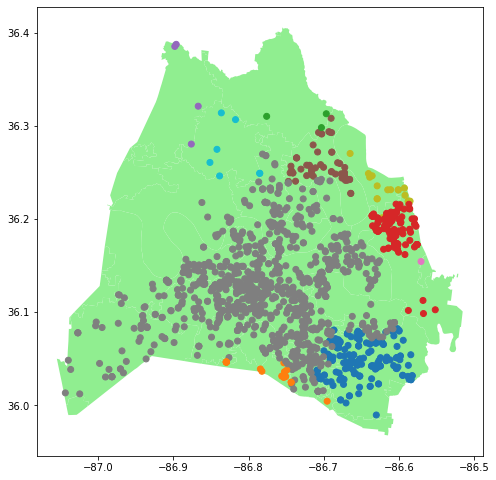

In [16]:
leg_kwds = {'title': 'po_name', 'loc': 'upper left', 
            'bbox_to_anchor': (1, 1.03), 'ncol': 2}

ax = zipcodes.plot(figsize = (8, 10), color = 'lightgreen')
Phone_Calls_Derechopd_zip.plot( ax = ax, column = 'po_name');

plt.show();

In [17]:
Phone_Calls_Derechopd_geo.centroid

C:\Users\MILTON~1\AppData\Local\Temp/ipykernel_9300/357960493.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  Phone_Calls_Derechopd_geo.centroid


0       POINT (-86.71685 36.24780)
1       POINT (-86.80062 36.14311)
2       POINT (-87.05633 36.10052)
3       POINT (-86.92782 36.13002)
4       POINT (-86.88188 36.14238)
                   ...            
1510    POINT (-86.77053 36.13169)
1511    POINT (-86.74345 36.04224)
1512    POINT (-86.65561 36.07766)
1513    POINT (-86.74356 36.02471)
1514    POINT (-86.81568 35.91424)
Length: 1515, dtype: geometry

In [18]:
zipcodes.geometry.centroid

C:\Users\MILTON~1\AppData\Local\Temp/ipykernel_9300/3801680343.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  zipcodes.geometry.centroid


0     POINT (-86.69477 36.25433)
1     POINT (-86.78898 36.14857)
2     POINT (-86.77467 36.10566)
3     POINT (-87.02866 36.00026)
4     POINT (-86.79086 36.15924)
5     POINT (-87.03712 36.08997)
6     POINT (-86.86263 36.38001)
7     POINT (-86.80157 36.13335)
8     POINT (-86.63653 35.98113)
9     POINT (-86.72226 36.00938)
10    POINT (-86.69470 36.00387)
11    POINT (-86.85733 36.37882)
12    POINT (-86.72570 36.00942)
13    POINT (-86.68513 35.99434)
14    POINT (-86.98674 36.15655)
15    POINT (-86.78317 36.16682)
16    POINT (-86.68331 35.99201)
17    POINT (-86.76289 36.39920)
18    POINT (-86.52221 36.13926)
19    POINT (-86.67866 35.98840)
20    POINT (-86.80236 36.14071)
21    POINT (-86.76851 36.16713)
22    POINT (-86.89242 36.27139)
23    POINT (-86.99584 36.11958)
24    POINT (-86.77702 36.16557)
25    POINT (-86.66271 36.16744)
26    POINT (-86.80250 36.14688)
27    POINT (-86.80805 36.17736)
28    POINT (-86.57718 36.18867)
29    POINT (-86.68156 35.99059)
30    POIN

In [19]:
zipcodes.geometry.area.max

C:\Users\MILTON~1\AppData\Local\Temp/ipykernel_9300/2611019161.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  zipcodes.geometry.area.max


<bound method NDFrame._add_numeric_operations.<locals>.max of 0     5.557648e-03
1     1.119608e-03
2     1.866022e-03
3     4.362119e-04
4     2.931916e-06
5     1.766846e-05
6     5.273980e-07
7     6.876326e-04
8     6.936496e-04
9     2.829140e-06
10    2.271818e-04
11    3.113901e-05
12    5.389971e-08
13    5.138957e-06
14    2.993970e-04
15    6.122573e-05
16    1.448759e-06
17    3.882926e-06
18    6.287220e-06
19    7.269823e-07
20    2.225557e-05
21    2.176945e-04
22    9.936641e-05
23    8.952573e-04
24    1.037754e-04
25    6.273079e-03
26    2.644073e-05
27    1.189596e-03
28    1.029588e-05
29    4.029814e-06
30    4.457195e-04
31    9.153075e-03
32    2.471405e-03
33    7.294225e-07
34    2.758813e-04
35    3.618160e-07
36    3.928318e-04
37    2.206043e-05
38    3.948925e-03
39    3.729013e-03
40    2.422010e-03
41    9.980615e-03
42    1.758869e-03
43    9.317673e-03
44    1.177024e-02
45    2.191718e-03
46    2.062032e-03
47    1.069092e-02
48    6.460545e-03
49    5

In [20]:
Phone_Calls_Derechopd_zip.geometry

0       POINT (-86.71685 36.24780)
65      POINT (-86.73612 36.26555)
75      POINT (-86.68977 36.25071)
76      POINT (-86.67872 36.25948)
97      POINT (-86.73037 36.25347)
                   ...            
848     POINT (-86.78309 36.16832)
860     POINT (-86.78208 36.16571)
985     POINT (-86.78790 36.19378)
1470    POINT (-86.69550 36.00447)
1473    POINT (-86.78320 36.17434)
Name: geometry, Length: 1456, dtype: geometry

In [21]:
center= Phone_Calls_Derechopd_zip.geometry.centroid
center

C:\Users\MILTON~1\AppData\Local\Temp/ipykernel_9300/2943799631.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  center= Phone_Calls_Derechopd_zip.geometry.centroid


0       POINT (-86.71685 36.24780)
65      POINT (-86.73612 36.26555)
75      POINT (-86.68977 36.25071)
76      POINT (-86.67872 36.25948)
97      POINT (-86.73037 36.25347)
                   ...            
848     POINT (-86.78309 36.16832)
860     POINT (-86.78208 36.16571)
985     POINT (-86.78790 36.19378)
1470    POINT (-86.69550 36.00447)
1473    POINT (-86.78320 36.17434)
Length: 1456, dtype: geometry

In [22]:
Phone_Calls_Derechopd_zip_center =[center.y, center.x]
print (Phone_Calls_Derechopd_zip_center)

[0       36.247802
65      36.265547
75      36.250710
76      36.259485
97      36.253467
          ...    
848     36.168324
860     36.165715
985     36.193784
1470    36.004472
1473    36.174341
Length: 1456, dtype: float64, 0      -86.716847
65     -86.736116
75     -86.689766
76     -86.678717
97     -86.730366
          ...    
848    -86.783089
860    -86.782079
985    -86.787897
1470   -86.695497
1473   -86.783195
Length: 1456, dtype: float64]


In [23]:
Phone_Calls_Derechopd_geo

,DateTime,CallTypeId,Latitude,Longitude,Cell_Tower_Address,geometry
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER,POINT (-86.71685 36.24780)
1,5/3/2020 16:30,911 Calls,36.143108,-86.800621,1161 21ST AV S - SE,POINT (-86.80062 36.14311)
2,5/3/2020 16:30,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N,POINT (-87.05633 36.10052)
3,5/3/2020 16:30,911 Calls,36.130021,-86.927819,5758 RIVER RD - SW,POINT (-86.92782 36.13002)
4,5/3/2020 16:31,911 Calls,36.142380,-86.881882,3744B ANNEX AVE - SE,POINT (-86.88188 36.14238)
...,...,...,...,...,...,...
1510,5/4/2020 0:18,911 Calls,36.131694,-86.770535,1823-C 12TH AV - SECTOR SE S,POINT (-86.77053 36.13169)
1511,5/4/2020 0:22,911 Calls,36.042237,-86.743455,5244-C EDMONSON PIKE - SECTOR SE,POINT (-86.74345 36.04224)
1512,5/4/2020 0:25,911 Calls,36.077664,-86.655607,2747-B MURFREESBORO PKE - SECTOR NW,POINT (-86.65561 36.07766)
1513,5/4/2020 0:29,911 Calls,36.024706,-86.743562,302 SUMMIT VIEW DR - E,POINT (-86.74356 36.02471)


In [24]:
area_map= folium.Map(location = [36.1622767,-86.7742984], zoom_start = 10)

folium.GeoJson(zipcodes).add_to(area_map)

area_map

In [25]:
Phone_Calls_Derechopd_map = folium.Map(location = [36.1622767,-86.7742984], zoom_start = 12)
Phone_Calls_Derechopd_map

In [26]:
zipcodes.head ()

,zip,objectid,po_name,shape_stlength,shape_starea,geometry
0,37115,1,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ..."
1,37203,33,NASHVILLE,93532.890729543782,120334624.37817383,"MULTIPOLYGON (((-86.78734 36.16688, -86.78711 ..."
2,37204,9,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ..."
3,37064,18,FRANKLIN,28995.828320601937,46969608.005737305,"MULTIPOLYGON (((-87.02197 36.01200, -87.02140 ..."
4,37246,57,NASHVILLE,2247.4521491892065,315078.17651367187,"MULTIPOLYGON (((-86.79052 36.15846, -86.79107 ..."


In [27]:
Phone_Calls_Derechopd_zip

,DateTime,CallTypeId,Latitude,Longitude,Cell_Tower_Address,geometry,zip,po_name
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER,POINT (-86.71685 36.24780),37115,MADISON
65,5/3/2020 16:44,911 Calls,36.265547,-86.736116,524 BOYDS HILLTOP DR - SW,POINT (-86.73612 36.26555),37115,MADISON
75,5/3/2020 16:46,911 Calls,36.250710,-86.689766,607E LARKIN SPRINGS RD - SW,POINT (-86.68977 36.25071),37115,MADISON
76,5/3/2020 16:46,911 Calls,36.259485,-86.678717,96 D VANDIVER DR - SECTOR S,POINT (-86.67872 36.25948),37115,MADISON
97,5/3/2020 16:51,911 Calls,36.253467,-86.730366,619 DUE WEST AVE. W - NE SECTOR,POINT (-86.73037 36.25347),37115,MADISON
...,...,...,...,...,...,...,...,...
848,5/3/2020 19:20,911 Calls,36.168324,-86.783089,500 5TH AV - SECTOR SW N,POINT (-86.78309 36.16832),37219,NASHVILLE
860,5/3/2020 19:22,911 Calls,36.165715,-86.782079,315-B 4TH AV - SECTOR NW N,POINT (-86.78208 36.16571),37219,NASHVILLE
985,5/3/2020 19:53,911 Calls,36.193784,-86.787897,275 CUMBERLAND BEND,POINT (-86.78790 36.19378),37228,NASHVILLE
1470,5/3/2020 23:25,911 Calls,36.004472,-86.695497,1598-A RAGSDALE RD - SECTOR N,POINT (-86.69550 36.00447),37027,BRENTWOOD


In [60]:
Phone_Calls_Derechopd_map = folium.Map(location = [36.1622767,-86.7742984], zoom_start = 10
                                      )

folium.GeoJson(zipcodes).add_to(Phone_Calls_Derechopd_map)

for row_index, row_values in Phone_Calls_Derechopd_zip.iterrows():
    loc = [row_values['Latitude'], row_values['Longitude']]
    pop = str(row_values['DateTime'])
    icon=folium.Icon(color="blue",icon="align-center", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 

    marker.add_to(Phone_Calls_Derechopd_map)
    

Phone_Calls_Derechopd_map

In [63]:
Phone_Calls_Derechopd_cluster_map= folium.Map(location = [36.1622767,-86.7742984], zoom_start = 10)

#create a marker cluster
marker_cluster = MarkerCluster().add_to(Phone_Calls_Derechopd_cluster_map)

folium.GeoJson(zipcodes).add_to(Phone_Calls_Derechopd_cluster_map)

# inside the loop add each marker to the cluster

for row_index, row_values in Phone_Calls_Derechopd_zip.iterrows():
    loc = [row_values['Latitude'], row_values['Longitude']]
    pop = str(row_values['DateTime'])
    icon=folium.Icon(color="red",icon="align-center", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 

    marker.add_to(marker_cluster)


Phone_Calls_Derechopd_cluster_map

In [81]:
Phone_Calls_Derechopd_1st_call = Phone_Calls_Derechopd_geo.sort_values('DateTime', ascending = True).head (1)
Phone_Calls_Derechopd_1st_call

,DateTime,CallTypeId,Latitude,Longitude,Cell_Tower_Address,geometry
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER,POINT (-86.71685 36.24780)


In [82]:
Phone_Calls_Derechopd_last_call = Phone_Calls_Derechopd_geo.sort_values('DateTime', ascending = False).head (1)
Phone_Calls_Derechopd_last_call

,DateTime,CallTypeId,Latitude,Longitude,Cell_Tower_Address,geometry
1514,5/4/2020 0:29,911 Calls,35.914241,-86.815679,2014 QUAIL HOLLOW CIR,POINT (-86.81568 35.91424)


In [100]:
Phone_Calls_Derechopd_cluster_map

for row_index, row_values in Phone_Calls_Derechopd_1st_call.iterrows():
    loc = [row_values['Latitude'], row_values['Longitude']]
    pop = str(row_values['DateTime'])
    icon=folium.Icon(color="blue",icon="align-center", prefix='fa')
    
    
    
for row_index, row_values in Phone_Calls_Derechopd_last_call.iterrows():
    loc = [row_values['Latitude'], row_values['Longitude']]
    pop = str(row_values['DateTime'])
    icon=folium.Icon(color="black",icon="align-center", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 

    marker.add_to(Phone_Calls_Derechopd_cluster_map)
    

Phone_Calls_Derechopd_cluster_map

In [30]:
Phone_Calls_Tornado = pd.read_csv ("../data/911_Phone_Calls_Tornado_030320.csv")
Phone_Calls_Tornado

,Seizure_DateTime,CallTypeId,Latitude,Longitude,Cell_Tower_Address
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector
1,3/3/2020 0:36,911 Calls,36.159634,-86.841904,4507D KENTUCKY AV - SE
2,3/3/2020 0:36,911 Calls,36.264153,-86.708862,329 THELMA ST - S Sector
3,3/3/2020 0:36,911 Calls,41.766759,-72.701173,526 FOUNDRY DR
4,3/3/2020 0:36,911 Calls,36.233467,-86.721077,5007B RUSKIN AVE - N
...,...,...,...,...,...
463,3/3/2020 4:54,911 Calls,36.142552,-86.635330,WIRELESS CALLER
464,3/3/2020 4:54,911 Calls,36.189415,-86.813557,WIRELESS CALLER
465,3/3/2020 4:55,911 Calls,36.223534,-86.757874,WIRELESS CALLER
466,3/3/2020 4:56,911 Calls,36.168398,-86.783774,600 DR MARTIN L KING JR BLVD - NE


In [31]:
Phone_Calls_Tornado['geometry']= Phone_Calls_Tornado.apply(lambda x: Point ((float(x.Latitude),
                                                                                 float(x.Longitude))),
                                                                axis = 1)
Phone_Calls_Tornado

,Seizure_DateTime,CallTypeId,Latitude,Longitude,Cell_Tower_Address,geometry
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector,POINT (36.072708 -86.665779)
1,3/3/2020 0:36,911 Calls,36.159634,-86.841904,4507D KENTUCKY AV - SE,POINT (36.159634 -86.841904)
2,3/3/2020 0:36,911 Calls,36.264153,-86.708862,329 THELMA ST - S Sector,POINT (36.264153 -86.708862)
3,3/3/2020 0:36,911 Calls,41.766759,-72.701173,526 FOUNDRY DR,POINT (41.766759 -72.701173)
4,3/3/2020 0:36,911 Calls,36.233467,-86.721077,5007B RUSKIN AVE - N,POINT (36.233467 -86.72107699999999)
...,...,...,...,...,...,...
463,3/3/2020 4:54,911 Calls,36.142552,-86.635330,WIRELESS CALLER,POINT (36.142552 -86.63533)
464,3/3/2020 4:54,911 Calls,36.189415,-86.813557,WIRELESS CALLER,POINT (36.189415 -86.813557)
465,3/3/2020 4:55,911 Calls,36.223534,-86.757874,WIRELESS CALLER,POINT (36.223534 -86.757874)
466,3/3/2020 4:56,911 Calls,36.168398,-86.783774,600 DR MARTIN L KING JR BLVD - NE,POINT (36.168398 -86.78377399999999)


In [32]:
Phone_Calls_Tornado_geo = gpd.GeoDataFrame(Phone_Calls_Tornado,
                                             crs = zipcodes.crs, 
                                             geometry = Phone_Calls_Tornado.geometry)
Phone_Calls_Tornado_geo

,Seizure_DateTime,CallTypeId,Latitude,Longitude,Cell_Tower_Address,geometry
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector,POINT (36.07271 -86.66578)
1,3/3/2020 0:36,911 Calls,36.159634,-86.841904,4507D KENTUCKY AV - SE,POINT (36.15963 -86.84190)
2,3/3/2020 0:36,911 Calls,36.264153,-86.708862,329 THELMA ST - S Sector,POINT (36.26415 -86.70886)
3,3/3/2020 0:36,911 Calls,41.766759,-72.701173,526 FOUNDRY DR,POINT (41.76676 -72.70117)
4,3/3/2020 0:36,911 Calls,36.233467,-86.721077,5007B RUSKIN AVE - N,POINT (36.23347 -86.72108)
...,...,...,...,...,...,...
463,3/3/2020 4:54,911 Calls,36.142552,-86.635330,WIRELESS CALLER,POINT (36.14255 -86.63533)
464,3/3/2020 4:54,911 Calls,36.189415,-86.813557,WIRELESS CALLER,POINT (36.18941 -86.81356)
465,3/3/2020 4:55,911 Calls,36.223534,-86.757874,WIRELESS CALLER,POINT (36.22353 -86.75787)
466,3/3/2020 4:56,911 Calls,36.168398,-86.783774,600 DR MARTIN L KING JR BLVD - NE,POINT (36.16840 -86.78377)


In [33]:
type (Phone_Calls_Tornado_geo)

geopandas.geodataframe.GeoDataFrame

In [34]:
area_map= folium.Map(location = [36.1622767,-86.7742984], zoom_start = 10)

folium.GeoJson(zipcodes).add_to(area_map)

area_map

In [35]:
Phone_Calls_Tornado_map = area_map

for row_index, row_values in Phone_Calls_Tornado_geo.iterrows():
    loc = [row_values['Latitude'], row_values['Longitude']]
    pop = str(row_values['Seizure_DateTime'])
    icon=folium.Icon(color="purple",icon="align-center", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 

    marker.add_to(Phone_Calls_Tornado_map)


Phone_Calls_Tornado_map

In [36]:
Phone_Calls_Tornado_map


In [37]:
damage_path = gpd.read_file('../data/path_polygons.geojson')
print (damage_path.crs)
damage_path

epsg:4326


,efscale,geometry
0,EF3,"POLYGON ((-85.59922 36.17660, -85.59840 36.176..."
1,EF1,"POLYGON ((-85.52390 36.17189, -85.52430 36.171..."
2,EF1,"POLYGON ((-85.61527 36.17529, -85.61403 36.175..."
3,EF3,"POLYGON ((-85.55185 36.17398, -85.55184 36.173..."
4,EF0,"POLYGON ((-86.94788 36.17248, -86.94582 36.172..."
5,EF0,"POLYGON ((-84.79918 36.12665, -84.79661 36.124..."
6,EF2,"POLYGON ((-86.31818 36.84809, -86.31659 36.847..."
7,EF0,"POLYGON ((-87.62268 32.68464, -87.62261 32.684..."
8,EF0,"POLYGON ((-87.04970 32.86477, -87.03895 32.861..."
9,EF1,"POLYGON ((-87.04224 32.86482, -87.03977 32.863..."


In [38]:
damage_path

,efscale,geometry
0,EF3,"POLYGON ((-85.59922 36.17660, -85.59840 36.176..."
1,EF1,"POLYGON ((-85.52390 36.17189, -85.52430 36.171..."
2,EF1,"POLYGON ((-85.61527 36.17529, -85.61403 36.175..."
3,EF3,"POLYGON ((-85.55185 36.17398, -85.55184 36.173..."
4,EF0,"POLYGON ((-86.94788 36.17248, -86.94582 36.172..."
5,EF0,"POLYGON ((-84.79918 36.12665, -84.79661 36.124..."
6,EF2,"POLYGON ((-86.31818 36.84809, -86.31659 36.847..."
7,EF0,"POLYGON ((-87.62268 32.68464, -87.62261 32.684..."
8,EF0,"POLYGON ((-87.04970 32.86477, -87.03895 32.861..."
9,EF1,"POLYGON ((-87.04224 32.86482, -87.03977 32.863..."


In [39]:
Phone_Calls_Tornado.info ()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 468 entries, 0 to 467
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   Seizure_DateTime    468 non-null    object  
 1   CallTypeId          468 non-null    object  
 2   Latitude            468 non-null    float64 
 3   Longitude           468 non-null    float64 
 4   Cell_Tower_Address  468 non-null    object  
 5   geometry            468 non-null    geometry
dtypes: float64(2), geometry(1), object(3)
memory usage: 22.1+ KB


In [40]:
zipcodes= gpd.read_file ('../data/zipcodes.geojson')
print(zipcodes.crs)
zipcodes

epsg:4326


,zip,objectid,po_name,shape_stlength,shape_starea,geometry
0,37115,1,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ..."
1,37203,33,NASHVILLE,93532.890729543782,120334624.37817383,"MULTIPOLYGON (((-86.78734 36.16688, -86.78711 ..."
2,37204,9,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ..."
3,37064,18,FRANKLIN,28995.828320601937,46969608.005737305,"MULTIPOLYGON (((-87.02197 36.01200, -87.02140 ..."
4,37246,57,NASHVILLE,2247.4521491892065,315078.17651367187,"MULTIPOLYGON (((-86.79052 36.15846, -86.79107 ..."
5,37143,23,PEGRAM,7047.8267580476522,1900364.756652832,"MULTIPOLYGON (((-87.03553 36.08659, -87.03556 ..."
6,37080,42,JOELTON,2319.8074237329579,56522.611450195313,"MULTIPOLYGON (((-86.86263 36.37811, -86.86264 ..."
7,37212,54,NASHVILLE,58759.243654332378,73920091.147705078,"MULTIPOLYGON (((-86.80790 36.14643, -86.80605 ..."
8,37135,7,NOLENSVILLE,69742.56063023665,74707266.403198242,"MULTIPOLYGON (((-86.67188 35.98955, -86.67189 ..."
9,37027,31,BRENTWOOD,3116.4327152718852,304596.06201171875,"MULTIPOLYGON (((-86.72012 36.00886, -86.72012 ..."


In [41]:
zipcodes = zipcodes [['zip', 'po_name', 'geometry']]
zipcodes

,zip,po_name,geometry
0,37115,MADISON,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ..."
1,37203,NASHVILLE,"MULTIPOLYGON (((-86.78734 36.16688, -86.78711 ..."
2,37204,NASHVILLE,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ..."
3,37064,FRANKLIN,"MULTIPOLYGON (((-87.02197 36.01200, -87.02140 ..."
4,37246,NASHVILLE,"MULTIPOLYGON (((-86.79052 36.15846, -86.79107 ..."
5,37143,PEGRAM,"MULTIPOLYGON (((-87.03553 36.08659, -87.03556 ..."
6,37080,JOELTON,"MULTIPOLYGON (((-86.86263 36.37811, -86.86264 ..."
7,37212,NASHVILLE,"MULTIPOLYGON (((-86.80790 36.14643, -86.80605 ..."
8,37135,NOLENSVILLE,"MULTIPOLYGON (((-86.67188 35.98955, -86.67189 ..."
9,37027,BRENTWOOD,"MULTIPOLYGON (((-86.72012 36.00886, -86.72012 ..."


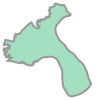

In [42]:
zipcodes.loc [0,'geometry']

<AxesSubplot:>

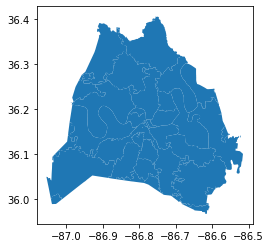

In [43]:
zipcodes.plot ()

In [44]:
tornado_paths= gpd.read_file('../data/tornado_paths.geojson')
print (tornado_paths.crs)
tornado_paths

epsg:4326


,objectid,event_id,stormdate,starttime,endtime,startlat,startlon,endlat,endlon,length,...,propdamage,edit_user,edit_time,created_user,created_date,last_edited_user,last_edited_date,comments,Shape__Length,geometry
0,879879,Nashville,1583217120000,1583217120000,1583220900000,36.1725,-86.9478,36.1532,-85.8860,60.1317,...,-99,None,None,DATians,1583461561000,dat_editor,1618703241000,"An historic, long-track, strong EF-3 tornado b...",1.071075,"LINESTRING (-86.94783 36.17249, -86.94461 36.1..."
1,879077,Hwy 69 Ballpark Tornado,1583237040000,1583237040000,1583237520000,32.6846,-87.6226,32.6863,-87.5492,4.3400,...,-99,None,None,DATians,1583353305000,DATians,1583358165000,None,0.074159,"LINESTRING (-87.62263 32.68464, -87.62182 32.6..."
2,879081,Lawley Tornado,1583238480000,1583238480000,1583239080000,32.8648,-87.0496,32.8646,-86.9432,6.2100,...,-99,None,None,DATians,1583357522000,DATians,1583359203000,Path,0.106695,"LINESTRING (-87.04956 32.86476, -87.04019 32.8..."
3,879877,Cookeville,1583221680000,1583221680000,1583222160000,36.1715,-85.6628,36.1709,-85.5135,8.3900,...,100000,None,None,DATians,1583461208000,DATians,1590771008000,"An historic, violent EF-4 tornado began in wes...",0.149870,"LINESTRING (-85.66285 36.17151, -85.61103 36.1..."
4,879878,Goffton,1583222700000,1583222700000,1583222760000,36.1075,-85.4461,36.1068,-85.4420,0.2300,...,-99,None,None,DATians,1583461360000,DATians,1590604073000,A very brief and weak EF-0 tornado touched dow...,0.004130,"LINESTRING (-85.44610 36.10746, -85.44203 36.1..."
5,879880,Cumberland,1583223900000,1583223900000,1583224500000,36.1399,-85.0401,36.1243,-84.8619,10.0700,...,-99,None,None,DATians,1583534817000,DATians,1590605084000,An EF-2 tornado touched down near the intersec...,0.179387,"LINESTRING (-85.04006 36.13989, -85.03400 36.1..."
6,888677,Buffalo Valley,1583221080000,1583221080000,1583221320000,36.1602,-85.8055,36.1711,-85.7479,3.3233,...,-99,None,None,DATians,1586271666000,DATians,1598799052000,An EF-0 tornado touched down near the Smith/Pu...,0.058826,"LINESTRING (-85.80550 36.16017, -85.79778 36.1..."


In [45]:
tornado_paths.info ()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 7 entries, 0 to 6
Data columns (total 29 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   objectid          7 non-null      int64   
 1   event_id          7 non-null      object  
 2   stormdate         7 non-null      int64   
 3   starttime         7 non-null      int64   
 4   endtime           7 non-null      int64   
 5   startlat          7 non-null      float64 
 6   startlon          7 non-null      float64 
 7   endlat            7 non-null      float64 
 8   endlon            7 non-null      float64 
 9   length            7 non-null      float64 
 10  width             7 non-null      int64   
 11  injuries          7 non-null      int64   
 12  fatalities        7 non-null      int64   
 13  efscale           7 non-null      object  
 14  efnum             7 non-null      int64   
 15  qc                7 non-null      object  
 16  maxwind           7 no

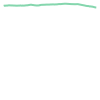

In [46]:
tornado_paths.loc [0,'geometry']

In [47]:
tornado_paths.plot

<bound method GeoDataFrame.plot of    objectid                 event_id      stormdate      starttime  \
0    879879                Nashville  1583217120000  1583217120000   
1    879077  Hwy 69 Ballpark Tornado  1583237040000  1583237040000   
2    879081           Lawley Tornado  1583238480000  1583238480000   
3    879877               Cookeville  1583221680000  1583221680000   
4    879878                  Goffton  1583222700000  1583222700000   
5    879880               Cumberland  1583223900000  1583223900000   
6    888677           Buffalo Valley  1583221080000  1583221080000   

         endtime  startlat  startlon   endlat   endlon   length  ...  \
0  1583220900000   36.1725  -86.9478  36.1532 -85.8860  60.1317  ...   
1  1583237520000   32.6846  -87.6226  32.6863 -87.5492   4.3400  ...   
2  1583239080000   32.8648  -87.0496  32.8646 -86.9432   6.2100  ...   
3  1583222160000   36.1715  -85.6628  36.1709 -85.5135   8.3900  ...   
4  1583222760000   36.1075  -85.4461  36.106

In [48]:
damage_path.plot

<bound method GeoDataFrame.plot of    efscale                                           geometry
0      EF3  POLYGON ((-85.59922 36.17660, -85.59840 36.176...
1      EF1  POLYGON ((-85.52390 36.17189, -85.52430 36.171...
2      EF1  POLYGON ((-85.61527 36.17529, -85.61403 36.175...
3      EF3  POLYGON ((-85.55185 36.17398, -85.55184 36.173...
4      EF0  POLYGON ((-86.94788 36.17248, -86.94582 36.172...
5      EF0  POLYGON ((-84.79918 36.12665, -84.79661 36.124...
6      EF2  POLYGON ((-86.31818 36.84809, -86.31659 36.847...
7      EF0  POLYGON ((-87.62268 32.68464, -87.62261 32.684...
8      EF0  POLYGON ((-87.04970 32.86477, -87.03895 32.861...
9      EF1  POLYGON ((-87.04224 32.86482, -87.03977 32.863...
10     EF2  POLYGON ((-86.31013 36.19273, -86.30967 36.192...
11     EF2  POLYGON ((-86.57133 36.17659, -86.57095 36.176...
12     EF3  POLYGON ((-86.75131 36.17683, -86.75151 36.176...
13     EF3  POLYGON ((-86.52686 36.18203, -86.52658 36.181...
14     EF2  POLYGON ((-86.55654 36.

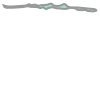

In [49]:
damage_path.loc [0,'geometry']

In [50]:
test = gpd.sjoin (damage_path,zipcodes,op= 'within')
test

,efscale,geometry,index_right,zip,po_name
12,EF3,"POLYGON ((-86.75131 36.17683, -86.75151 36.176...",46,37206,NASHVILLE
26,EF2,"POLYGON ((-86.75950 36.17679, -86.75943 36.176...",46,37206,NASHVILLE
15,EF2,"POLYGON ((-86.60015 36.18039, -86.60036 36.180...",31,37076,HERMITAGE
16,EF2,"POLYGON ((-86.58657 36.17843, -86.58684 36.178...",31,37076,HERMITAGE
20,EF3,"POLYGON ((-86.65025 36.18421, -86.65066 36.184...",25,37214,NASHVILLE
30,EF2,"POLYGON ((-86.67936 36.17845, -86.67906 36.178...",25,37214,NASHVILLE
21,EF2,"POLYGON ((-86.77426 36.17670, -86.77438 36.176...",21,37213,NASHVILLE
27,EF2,"POLYGON ((-86.82855 36.17597, -86.82482 36.175...",27,37208,NASHVILLE
28,EF2,"POLYGON ((-86.80570 36.17506, -86.80547 36.174...",27,37208,NASHVILLE


In [51]:
test.info ()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 9 entries, 12 to 28
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   efscale      9 non-null      object  
 1   geometry     9 non-null      geometry
 2   index_right  9 non-null      int64   
 3   zip          9 non-null      object  
 4   po_name      9 non-null      object  
dtypes: geometry(1), int64(1), object(3)
memory usage: 432.0+ bytes
